#  利用多光谱遥感数据进行地物分类

#### 本课程目的是利用神经网络开展多光谱地物分类，学习从整幅卫星影像制作样本数据集，训练多分类神经网络，并实现对整景卫星数据的预测。
运行该代码提前需要安装以下几个必要的库
1. numpy
2. tensorflow = 2.5 
3. h5py = 3.1
4. Pillow = 8.4 

In [16]:
import h5py
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.optimizers import RMSprop,Adam
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau,CSVLogger
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import time,glob
from model import all_model
from utils import *
import os,sys, importlib
importlib.reload(sys.modules['utils'])
importlib.reload(sys.modules['model'])


<module 'model' from 'x:\\WRSDP\\Third Week\\Lesson3\\model.py'>

### 1. 加载并查看数据


In [6]:
## 加载数据集，数据集维度为3840×3840×4，最后一个波段是真值标签，标签一共有六类，“”
hdf5_path = "./data/kaggle_14_8b_6c.hdf5"
fd = h5py.File(hdf5_path, 'r')
fd.keys()
images=fd['image']
labels=fd['label']
n_label=len(np.unique(labels))
## 该影像是反射率数据（通常数值在0-1之间），为了节省存储空间常将数值放大10000倍，保存为无符号整型数据
print(np.max(images),np.min(images),np.max(labels),np.min(labels))
images=np.array(images)[:,:,:,:3]
labels=np.array(labels)
print(images.shape,labels.shape)


9995 38 5 0
(14, 3840, 3840, 3) (14, 3840, 3840)


9995 1.0


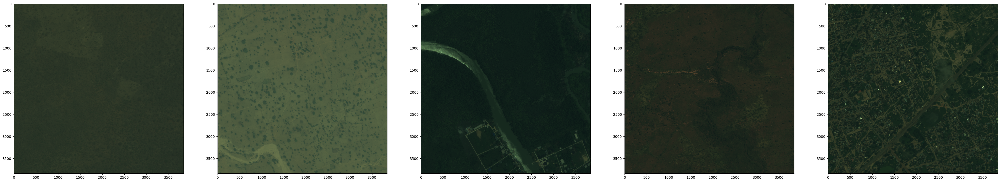

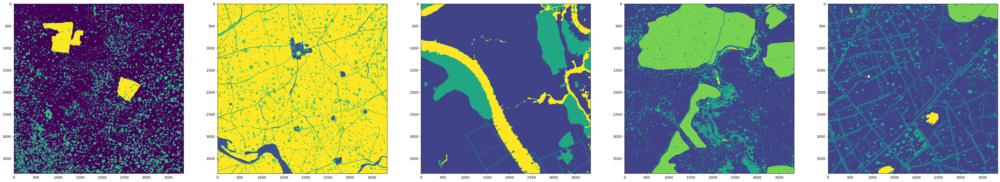

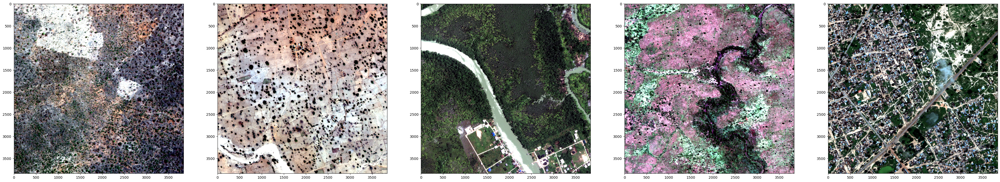

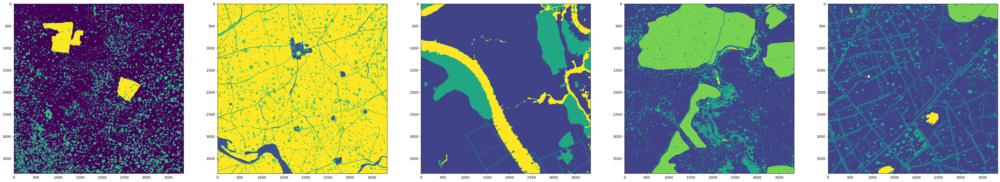

In [3]:
## 将整幅影像及标签数据打印出来,为了提升原始影像的显示效果，对原有数据进行拉伸处理 

def stretch(data, lower_percent=5, higher_percent=95):##设置分位数可以剔除个别异常值
    data=np.array(data,dtype=np.float32)
    min = np.percentile(data, lower_percent)*1.0
    max = np.percentile(data, higher_percent) *1.0
    data[data<min] = min
    data[data>max] = max
    return data.astype(np.float32)

newimg=adjust_contrast(images.copy()) #copy目的是为了后面对比的需求，不对原始数据进行更改
print(np.max(images),np.max(newimg))
show_5_images(images/10000,labels)
show_5_images(newimg,labels)



### 2. 数据切片

In [43]:
## 定义随机裁剪和顺序裁剪两种方式，顺序裁剪是按照固定步长沿行列循环裁剪，切片数是有限的，随机裁剪是以随机点为起始点裁剪，切片数可以是无限的且可自定义，后者的好处是可以通过增加算法约束label中某一类的数量来实现精准的样本获取。
def random_crop(image,crop_sz):
    img_sz=image.shape[:2]
    random_x = np.random.randint(0,img_sz[0]-crop_sz+1) ##生成随机点
    random_y = np.random.randint(0,img_sz[1]-crop_sz+1)
    s_img = image[random_x:random_x+crop_sz,random_y:random_y+crop_sz,:] ##以随机点为起始点生成样本框，进行切片
    return s_img

def data_crop_random(img_arr,crop_sz,n_patch):   
    c = img_arr.shape[-1]
    data = np.zeros([n_patch, crop_sz, crop_sz, c])
    for j in np.arange(n_patch):
        image = random_crop(img_arr,crop_sz)
        data[ j,:,:,:] = image
    return data
def sequential_crop(imagearray,crop_sz,step=256):
    data = []
    x=0
    row_num = ((imagearray.shape)[0] - step) // step  ##最多能裁剪几行 几列
    col_num=((imagearray.shape)[1] - step) // step
    x_start=0
    y_start=0
    for h in range(row_num):
        for w in range(col_num):
            crop_img = imagearray[crop_sz*h+y_start:crop_sz*(h+1)+y_start, crop_sz*w+x_start:crop_sz*(w+1)+x_start,:] ##行列循环，滑动窗口移动              
            data.append(crop_img)
            x=x+1
    data=np.array(data)
    return data
def data_crop(imagearray,crop_sz,stride,random=None,n_patch=250):   
    data = []
    for i in range(imagearray.shape[0]):
        if random:
            image=data_crop_random(imagearray[i,:,:,:],crop_sz,n_patch)
        else:
            image =sequential_crop(imagearray[i,:,:,:],crop_sz,stride)
        if i == 0:
            data  = image ##注意当i=0的时候需要将image赋给data，否则data依然是空，不可以进行concatnate
        else:
            data  = np.concatenate((data, image), axis = 0) 
        print("patch processing....:"+str(i))
    data=np.array(data,dtype=np.float32)
    print("final processed:"+str(i)+"...No.:"+str(data.shape[0]))    
    return data


In [16]:
## 合并images和labels方便切片
data_all = np.concatenate((newimg, np.expand_dims(labels,axis=-1)), axis = -1)
stride=256
cropsize=256
all_patches=data_crop(data_all,cropsize,stride,random=True)##保留2景数据做测试
print(data_all.shape,all_patches.shape)
i=0


patch processing....:0
patch processing....:1
patch processing....:2
patch processing....:3
patch processing....:4
patch processing....:5
patch processing....:6
patch processing....:7
patch processing....:8
patch processing....:9
patch processing....:10
patch processing....:11
patch processing....:12
patch processing....:13
final processed:13...No.:3500
(14, 3840, 3840, 4) (3500, 256, 256, 4)


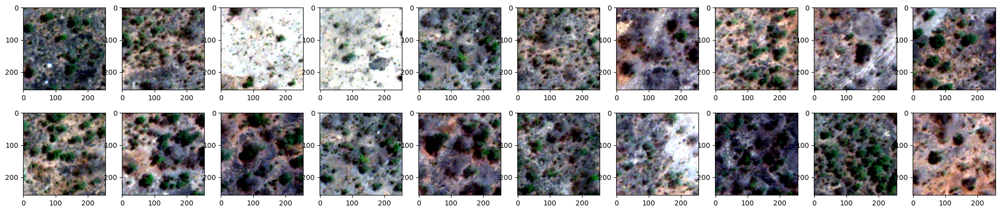

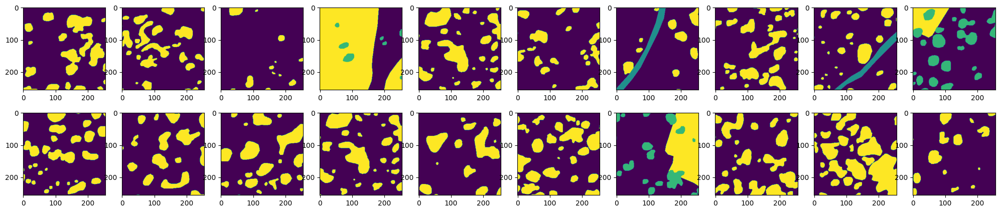

In [17]:
##调用utils中的plot_func查看数据与label是否对应,反复运行这个cell进行数据浏览i表示每次浏览跨越数据的个数
plot_func(all_patches[i:i+20,:,:,:3],all_patches[i:i+20:,:,:,-1])
i+=500

In [ ]:
all_patches=suffle_data(all_patches)

In [18]:
##可以选择将数据保存为h5文件，方便后续使用
hdf5_path = './data/patches_rgb_4b_6c.hdf5' 
f = h5py.File(hdf5_path, mode='w')
f['image'] = all_patches[:,:,:,0:-1]
f['label'] = all_patches[:,:,:,-1]
f.close()

### 3. 模型训练

In [5]:
hdf5_path = "./data/patches_14rgb_4b_6c.hdf5"
fd = h5py.File(hdf5_path, 'r')
fd.keys()
images=np.array(fd['image'])
labels=np.array(fd['label'])#3:tree,4:road,5:crop

In [25]:
## 对数据进行归一化处理，并将label转成one-hot标签形式
n_label=6
def post_normalize_image(images,labels,n_label=n_label):
    msk = label_hot(labels,n_label)
    img = images
    return img,msk
img,msk=post_normalize_image(images,labels,n_label)
# img,msk=post_normalize_image(all_patches[:,:,:,0:-1],all_patches[:,:,:,-1],n_label)
## 将数据集按照7:3进行划分
xtrain,xtest,ytrain,ytest=train_test_split(img,msk,test_size=0.2,random_state=42)
del img,msk #如果数据较大可以在此删除降低内存
print(xtrain.shape,xtest.shape,ytrain.shape,ytest.shape)
i=0

(2800, 256, 256, 3) (700, 256, 256, 3) (2800, 256, 256, 6) (700, 256, 256, 6)


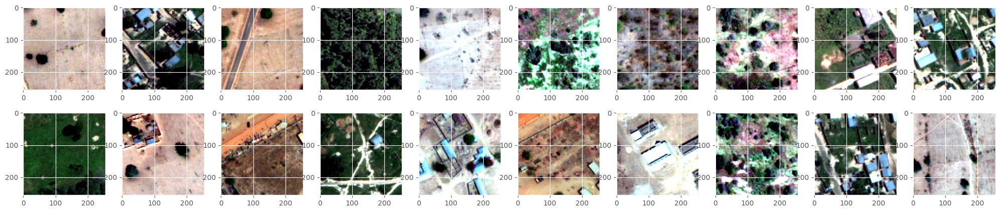

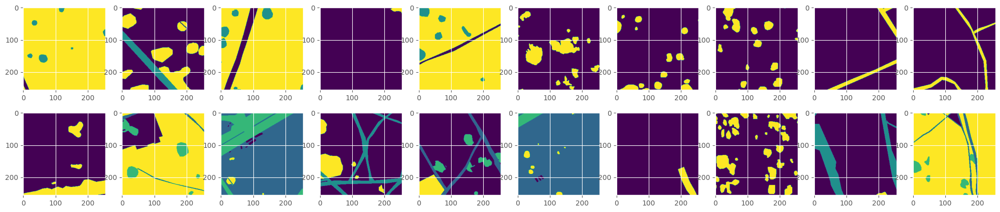

In [26]:
plot_func(xtrain[i:i+20,:,:,:3],np.argmax(ytrain,axis=-1)[i:i+20:,:,:])
i+=500

In [30]:
## 设定必要的参数
loss='categorical_crossentropy'
optimizer=Adam()
loss_weights=''
metrics=['accuracy']
batch_size=20
epoch= 50
input_height=xtrain.shape[1]
input_width=xtrain.shape[2]
nchannel=xtrain.shape[-1]
num_train=xtrain.shape[0]
num_val=xtest.shape[0]
ATM=all_model(loss,loss_weights,optimizer,metrics,input_height,input_width,n_label,nchannel)
modelname='unet'

In [31]:
## 加载UNET模型
model=ATM.UNET()#deeplabv3p,UNET,dlinknet,convattunet
# model.summary()

In [32]:
## 开始训练
begin_time = time.time()          
out_dir = "./checkpoint/"+modelname+'/'
if not os.path.exists(out_dir):
    os.makedirs(out_dir) 
model_checkpoint = ModelCheckpoint(filepath=out_dir+"-{epoch:02d}e-val_loss{val_loss:2f}.hdf5",monitor="val_loss",save_best_only=True,mode='auto')
csvlogger =CSVLogger(filename=out_dir+modelname+'-'+str(epoch)+'-log.csv', separator=',', append=False)
result=model.fit(xtrain, ytrain, batch_size=batch_size, epochs=epoch, verbose=1, shuffle=True,validation_data=(xtest, ytest),callbacks=[model_checkpoint,csvlogger])
end_time = time.time()
print('time lapsing {0} s \n'.format(end_time - begin_time))

Epoch 1/50
140/140 [==============================] - 31s 211ms/step - loss: 0.9534 - accuracy: 0.6366 - val_loss: 0.9204 - val_accuracy: 0.6542
Epoch 2/50
140/140 [==============================] - 28s 198ms/step - loss: 0.7653 - accuracy: 0.7321 - val_loss: 0.7569 - val_accuracy: 0.7359
Epoch 3/50
140/140 [==============================] - 28s 200ms/step - loss: 0.6927 - accuracy: 0.7468 - val_loss: 0.7197 - val_accuracy: 0.7401
Epoch 4/50
140/140 [==============================] - 28s 199ms/step - loss: 0.6520 - accuracy: 0.7648 - val_loss: 0.6722 - val_accuracy: 0.7483
Epoch 5/50
140/140 [==============================] - 28s 199ms/step - loss: 0.6002 - accuracy: 0.7853 - val_loss: 0.6150 - val_accuracy: 0.7760
Epoch 6/50
140/140 [==============================] - 28s 199ms/step - loss: 0.5782 - accuracy: 0.7947 - val_loss: 0.6107 - val_accuracy: 0.7849
Epoch 7/50
140/140 [==============================] - 28s 199ms/step - loss: 0.5369 - accuracy: 0.8130 - val_loss: 0.5976 - val_ac

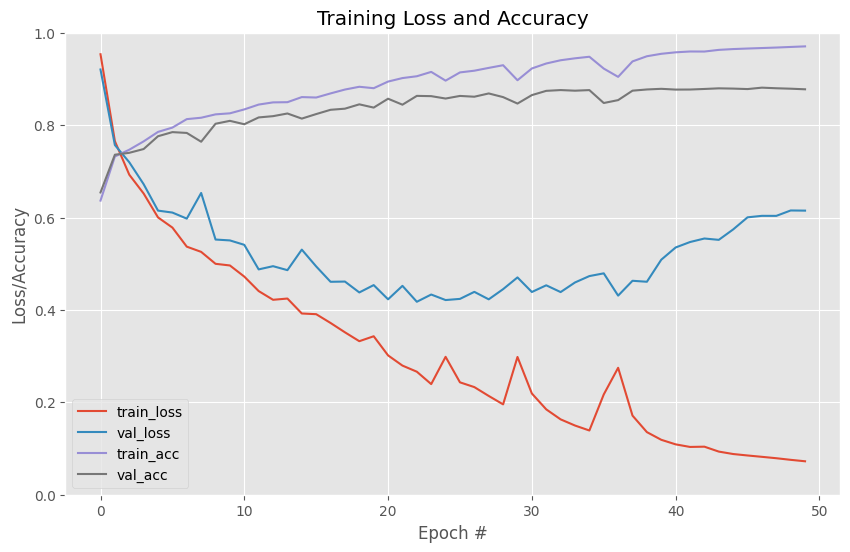

In [33]:
## 打印训练曲线，确认训练效果
def plot_fig(H,outdir):
    N=len(H.history['loss'])
    plt.style.use("ggplot")
    plt.figure(figsize=(10,6))
    plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
    plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
    plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
    plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
    plt.ylim(0,1)

    plt.title("Training Loss and Accuracy")
    plt.xlabel("Epoch #")
    plt.ylabel("Loss/Accuracy")
    plt.legend(loc="lower left")
    plt.savefig(outdir)
plot_fig(result,modelname+"_Loss_Acc_epoch.png")

### 4. 评价测试

In [34]:
h5=glob.glob("./checkpoint/"+modelname+"/*.hdf5")
model_list=np.sort(h5)
model=load_model(model_list[-1])
# model=load_model(model_list[-1],custom_objects={'interpolation':interpolation})
print(model_list[-1])

./checkpoint/unet\-23e-val_loss0.417657.hdf5


In [35]:
## 首先对切片数据进行预测，查看效果
i=100
pred=model.predict(xtest,batch_size=64)
pred=np.argmax(pred,axis=-1)
gt=np.argmax(ytest,axis=-1)


11/11 [==============================] - 2s 151ms/step


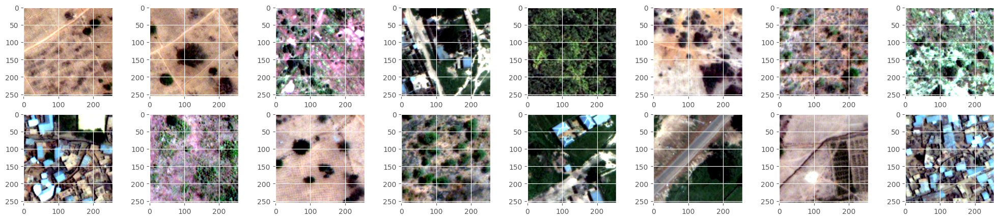

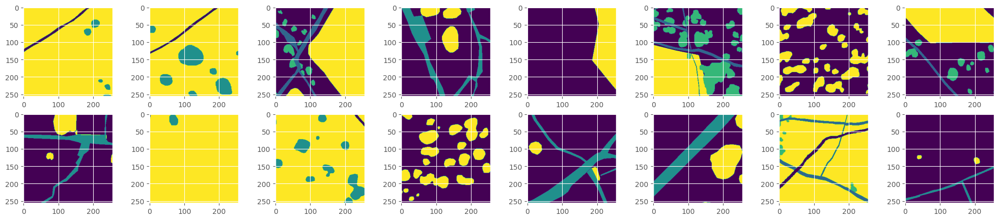

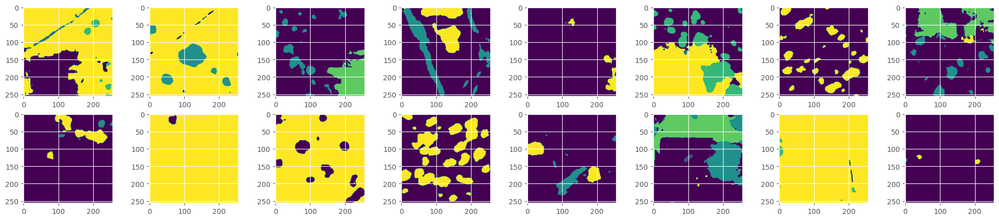

In [36]:
val_plot_func(xtest[i:i+20],gt[i:i+20],pred[i:i+20])
i+=100

In [37]:
df = call_matric(pred,gt, [0,1,2,3,4,5, 'all'])
print(df)

     precision    recall  F1-score       iou        oa      miou
0          NaN  0.000000       NaN  0.000000       NaN       NaN
1     0.874222  0.890027  0.882054  0.788995  0.863302  0.508574
2     0.732482  0.305576  0.431245  0.274897  0.863302  0.508574
3     0.765013  0.754585  0.759763  0.612595  0.863302  0.508574
4     0.879286  0.938908  0.908120  0.831703  0.863302  0.508574
5     0.810515  0.622284  0.704035  0.543252  0.863302  0.508574
all        NaN  0.585230       NaN  0.508574       NaN       NaN


x:\WRSDP\Third Week\Lesson3\utils.py:190: RuntimeWarning: invalid value encountered in true_divide
  return recall
x:\WRSDP\Third Week\Lesson3\utils.py:199: RuntimeWarning: invalid value encountered in true_divide
  intersection = np.diag(confusionMatrix)


### 4. 优化改进

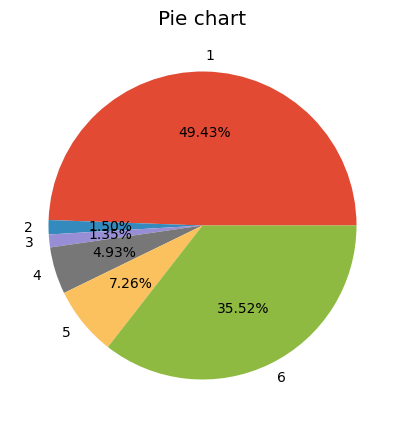

In [139]:
## 由下图可以看出各类别占比极为不均，使得模型精度更偏向于占比重的类别，而忽视占比少的类别
def Statistics_proportion(label):
    n_label = label.shape[-1]
    proportion = []
    name = []
    for i in range(n_label):
        proportion.append(np.sum(label[:,:,:,i] == 1))
        name.append(str(i+1))
    fig = plt.figure(figsize=(5,5))
    plt.pie(proportion,labels=name,autopct='%1.2f%%') #画饼图（数据，数据对应的标签，百分数保留两位小数点）
    plt.title("Pie chart")
    return proportion
proportion = Statistics_proportion(ytrain)

In [13]:
## 定义随机裁剪增加对于label中1和2样本的采集
def data_crop_random2(img_arr,crop_sz,n_patch):   
    data =[]
    k=0
    for j in np.arange(2000):
        image = random_crop(img_arr,crop_sz)
        if num_count(image[:,:,-1],2) >5000:
            data.append(image)
            k+=1
            if k==n_patch:
                break                 
    if k == 0:
        data  = np.expand_dims(image,axis=0) ##注意如果k=0，即没有符合条件的数据将最后一个image赋给data，避免data为空
    else:
        data  = np.array(data,dtype=np.float32)

    print(data.shape)
    return data.astype(np.float32)
def data_crop2(imagearray,crop_sz,stride,random=None,n_patch=250):   
    data = []
    for i in range(imagearray.shape[0]):
        if random:
            image=data_crop_random2(imagearray[i,:,:,:],crop_sz,n_patch)
        else:
            image =sequential_crop(imagearray[i,:,:,:],crop_sz,stride)
        if i == 0:
            data  = image ##注意当i=0的时候需要将image赋给data，否则data依然是空，不可以进行concatnate
        else:
            data  = np.concatenate((data, image), axis = 0) 
        print("patch processing....:"+str(i))
    data=np.array(data,dtype=np.float32)
    print("final processed:"+str(i)+"...No.:"+str(data.shape[0]))    
    return data

In [17]:
## 新增加样本的采集
data_all = np.concatenate((newimg, np.expand_dims(labels,axis=-1)), axis = -1)
stride=256
cropsize=256
all_patches2=data_crop2(data_all,cropsize,stride,random=True)
print(data_all.shape,all_patches2.shape)
i=0


(12, 256, 256, 4)
patch processing....:0
(122, 256, 256, 4)
patch processing....:1
(61, 256, 256, 4)
patch processing....:2
(7, 256, 256, 4)
patch processing....:3
(250, 256, 256, 4)
patch processing....:4
(250, 256, 256, 4)
patch processing....:5
(250, 256, 256, 4)
patch processing....:6
(250, 256, 256, 4)
patch processing....:7
(250, 256, 256, 4)
patch processing....:8
(250, 256, 256, 4)
patch processing....:9
(250, 256, 256, 4)
patch processing....:10
(250, 256, 256, 4)
patch processing....:11
(185, 256, 256, 4)
patch processing....:12
(206, 256, 256, 4)
patch processing....:13
final processed:13...No.:2593
(14, 3840, 3840, 4) (2593, 256, 256, 4)


In [18]:
all_patches2=suffle_data(all_patches2)

(2593, 256, 256, 4)


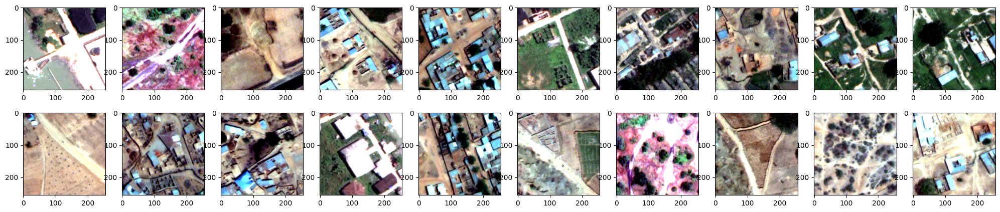

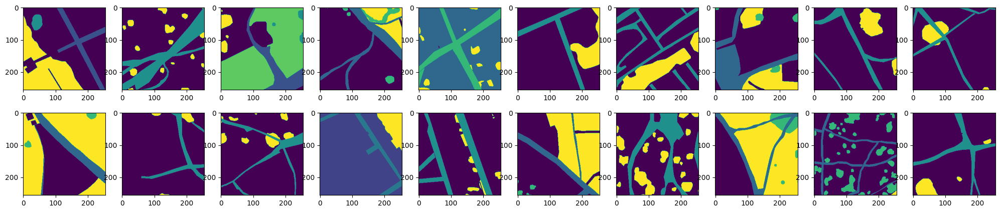

In [19]:
plot_func(all_patches2[i:i+20,:,:,:3],all_patches2[i:i+20:,:,:,-1])
i+=500

In [20]:
hdf5_path = "./data/patches_14rgb_4b_6c.hdf5"
fd = h5py.File(hdf5_path, 'r')
fd.keys()
images2=np.array(fd['image'])
labels2=np.array(fd['label'])#3:tree,4:road,5:crop

In [21]:
newimages=np.concatenate((images2,all_patches2[:,:,:,0:-1]),axis=0)
newlabels=np.concatenate((labels2,all_patches2[:,:,:,-1]),axis=0)
print(newimages.shape,newlabels.shape)


(6093, 256, 256, 3) (6093, 256, 256)


In [22]:
##可以选择将数据保存为h5文件，方便后续使用
hdf5_path = './data/patches2_14rgb_4b_6c.hdf5' 
f = h5py.File(hdf5_path, mode='w')
f['image'] = newimages
f['label'] = newlabels
f.close()

In [7]:
# hdf5_path = './data/patches2_rgb_4b_5c.hdf5' 
# fd = h5py.File(hdf5_path, 'r')
# fd.keys()
# newimages=np.array(fd['image'])
# newlabels=np.array(fd['label'])#3:tree,4:road,5:crop

In [23]:
## 对数据进行归一化处理，并将label转成one-hot标签形式
n_label=6
def post_normalize_image(images,labels,n_label=n_label):
    msk = label_hot(labels,n_label)
    img = images
    return img,msk
img,msk=post_normalize_image(newimages,newlabels,n_label)
# 将数据集按照7:3进行划分
xtrain,xtest,ytrain,ytest=train_test_split(img,msk,test_size=0.2,random_state=42)
del img,msk #如果数据较大可以在此删除降低内存
print(xtrain.shape,xtest.shape,ytrain.shape,ytest.shape)
i=0

(4874, 256, 256, 3) (1219, 256, 256, 3) (4874, 256, 256, 6) (1219, 256, 256, 6)


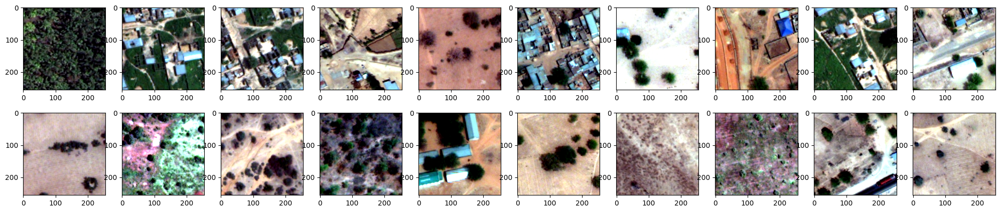

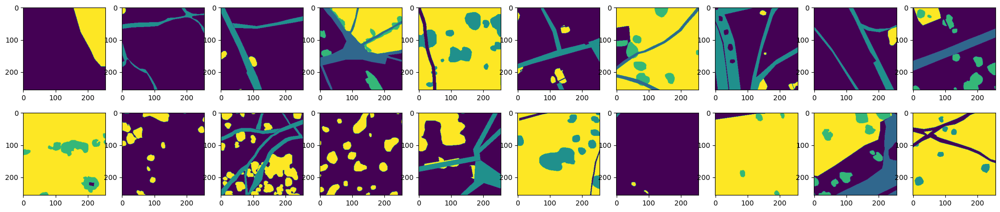

In [24]:
plot_func(xtrain[i:i+20,:,:,:3],np.argmax(ytrain,axis=-1)[i:i+20:,:,:])
i+=500

In [28]:
# from sklearn.utils.class_weight import compute_class_weight
# classes = np.unique(labels)  
# class_weight = compute_class_weight(class_weight='balanced', classes=classes, y=labels.reshape(-1))
class_weight=np.array([868,11.02639902,11.53030095,3.39023122,2.30442476,0.45978892])
# # class_weight=np.array([0.35,4.48,2.07,0.68,28.55])
print(class_weight)

[8.68000000e+02 1.10263990e+01 1.15303010e+01 3.39023122e+00
 2.30442476e+00 4.59788920e-01]


In [29]:
from keras import backend as K
import tensorflow as tf
def weighted_categorical_crossentropy(weights):
    """
    Usage:
        weights = np.array([0.5,2,10]) # Class one at 0.5, class 2 twice the normal weights, class 3 10x.
        loss = weighted_categorical_crossentropy(weights)
    """
    weights = K.variable(weights)
    def loss(y_true, y_pred):
        # scale predictions so that the class probas of each sample sum to 1
        y_pred /= K.sum(y_pred, axis=-1, keepdims=True)
        # clip to prevent NaN's and Inf's
        y_pred = K.clip(y_pred, K.epsilon(), 1 - K.epsilon())
        # calc
        loss = y_true * K.log(y_pred) * weights
        loss = -K.sum(loss, -1)
        return loss
    return loss
def interpolation(x, shape,method=0):
    # """0：双线性差值。1：最近邻居法。2：双三次插值法。3：面积插值法"""
    import tensorflow as tf
    # The height and breadth to which the pooled feature maps are to be interpolated
    h_to, w_to = shape
    # Bilinear Interpolation (Default method of this tf function is method=ResizeMethod.BILINEAR)
    resized = tf.image.resize(x, [h_to, w_to])
    return resized

In [30]:
## 设定必要的参数
loss=weighted_categorical_crossentropy(class_weight)
optimizer=Adam()
loss_weights=''
metrics=['accuracy']
batch_size=10
epoch= 50
input_height=xtrain.shape[1]
input_width=xtrain.shape[2]
nchannel=xtrain.shape[-1]
num_train=xtrain.shape[0]
num_val=xtest.shape[0]
ATM=all_model(loss,loss_weights,optimizer,metrics,input_height,input_width,n_label,nchannel)
modelname='convattunet'

In [31]:
## 加载UNET模型
model=ATM.convattunet()#deeplabv3p,UNET,dlinknet,convattunet
# model.summary()

384


In [32]:
## 开始训练
begin_time = time.time()          
out_dir = "./checkpoint/"+modelname+'/'
if not os.path.exists(out_dir):
    os.makedirs(out_dir) 
model_checkpoint = ModelCheckpoint(filepath=out_dir+"-{epoch:02d}e-val_loss{val_loss:2f}.hdf5",monitor="val_loss",save_best_only=True,mode='auto')
csvlogger =CSVLogger(filename=out_dir+modelname+'-'+str(epoch)+'-log.csv', separator=',', append=False)
result=model.fit(xtrain, ytrain, batch_size=batch_size, epochs=epoch, verbose=1, shuffle=True,validation_data=(xtest, ytest),callbacks=[model_checkpoint,csvlogger])
end_time = time.time()
print('time lapsing {0} s \n'.format(end_time - begin_time))

Epoch 1/50
488/488 [==============================] - 174s 338ms/step - loss: 5.5912 - accuracy: 0.6552 - val_loss: 12.8643 - val_accuracy: 0.3844
Epoch 2/50
488/488 [==============================] - 157s 322ms/step - loss: 4.4646 - accuracy: 0.7114 - val_loss: 3.7463 - val_accuracy: 0.7665
Epoch 3/50
488/488 [==============================] - 157s 322ms/step - loss: 3.6604 - accuracy: 0.7478 - val_loss: 3.3197 - val_accuracy: 0.7654
Epoch 4/50
488/488 [==============================] - 157s 321ms/step - loss: 3.2749 - accuracy: 0.7737 - val_loss: 3.4363 - val_accuracy: 0.8018
Epoch 5/50
488/488 [==============================] - 157s 321ms/step - loss: 2.9192 - accuracy: 0.7940 - val_loss: 3.1040 - val_accuracy: 0.7119
Epoch 6/50
488/488 [==============================] - 157s 321ms/step - loss: 2.6992 - accuracy: 0.8084 - val_loss: 2.8424 - val_accuracy: 0.7916
Epoch 7/50
488/488 [==============================] - 157s 321ms/step - loss: 2.5205 - accuracy: 0.8190 - val_loss: 2.6743 

In [34]:
def plot_fig(H,outdir):
    N=len(H.history['loss'])
    plt.style.use("ggplot")
    plt.figure(figsize=(10,6))
    plt.plot(np.arange(0, N), H.history["loss"], label="train_loss")
    plt.plot(np.arange(0, N), H.history["val_loss"], label="val_loss")
    plt.plot(np.arange(0, N), H.history["accuracy"], label="train_acc")
    plt.plot(np.arange(0, N), H.history["val_accuracy"], label="val_acc")
    plt.ylim(0,1)

    plt.title("Training Loss and Accuracy")
    plt.xlabel("Epoch #")
    plt.ylabel("Loss/Accuracy")
    plt.legend(loc="lower left")
    plt.savefig(outdir)

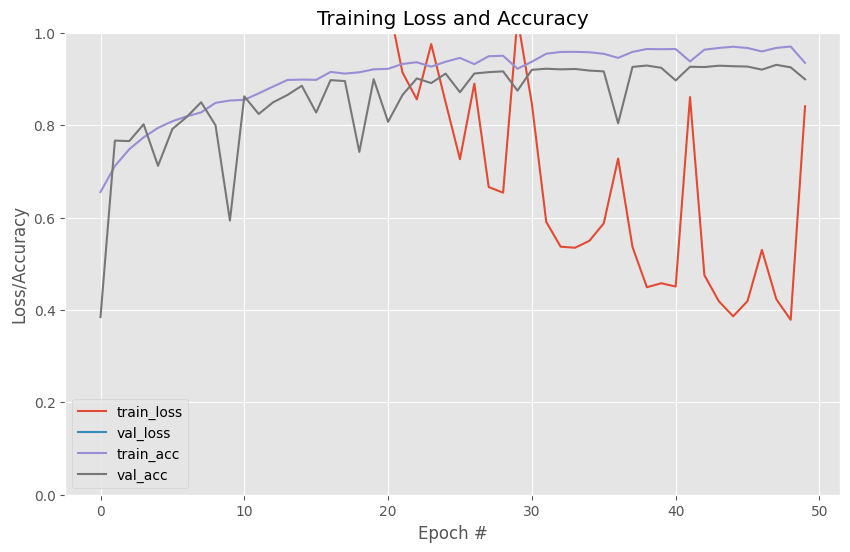

In [35]:
## 打印训练曲线，确认训练效果
plot_fig(result,modelname+"_Loss_Acc_epoch.png")

In [36]:
h5=glob.glob("./checkpoint/"+modelname+"/*.hdf5")
model_list=np.sort(h5)
# model=load_model(model_list[-1])
model=load_model(model_list[-1],custom_objects={'loss':weighted_categorical_crossentropy})
print(model_list[-1])

./checkpoint/convattunet\-36e-val_loss1.655682.hdf5


In [37]:
## 首先对切片数据进行预测，查看效果
i=100
pred=model.predict(xtest,batch_size=64)
pred=np.argmax(pred,axis=-1)
gt=np.argmax(ytest,axis=-1)


20/20 [==============================] - 15s 578ms/step


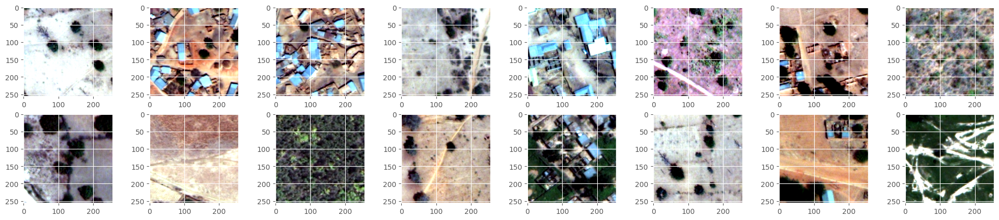

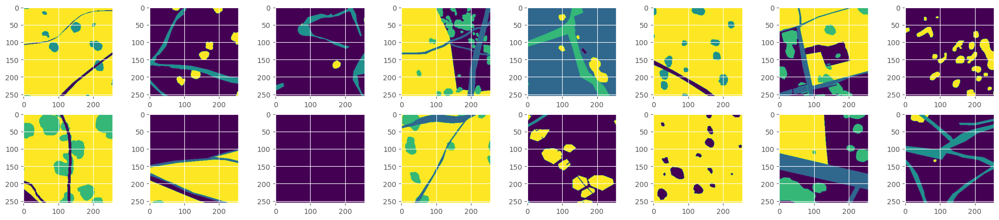

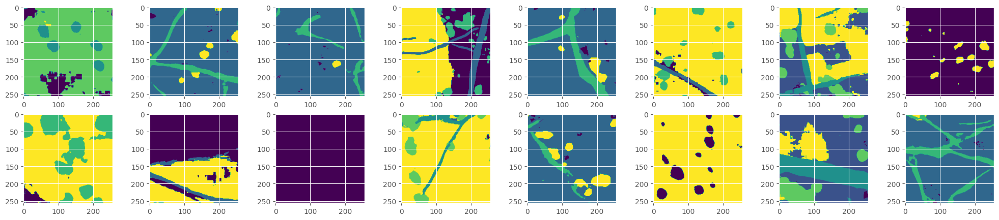

In [38]:
val_plot_func(xtest[i:i+20],gt[i:i+20],pred[i:i+20])
i+=20

In [39]:
df = call_matric(pred,gt, [0,1,2,3,4,5,'all'])
print(df)

     precision    recall  F1-score       iou        oa      miou
0     0.077300  0.943445  0.142892  0.076943  0.916316  0.620684
1     0.911622  0.958140  0.934302  0.876705  0.916316  0.620684
2     0.842525  0.874761  0.858340  0.751836  0.916316  0.620684
3     0.853711  0.736809  0.790964  0.654210  0.916316  0.620684
4     0.970585  0.912072  0.940419  0.887539  0.916316  0.620684
5     0.982798  0.480886  0.645787  0.476873  0.916316  0.620684
all   0.773090  0.817686  0.718784  0.620684  0.916316  0.620684


In [41]:
test_data  = h5py.File('./data/kaggle_test2_3b_6c.hdf5', 'r')
testimg = np.array(test_data['image'])
testlabel=np.array(test_data['label'])
print(testimg.shape,testlabel.shape)

(2, 3840, 3840, 3) (2, 3840, 3840)


In [42]:
image=adjust_contrast(testimg)
np.max(image),np.max(testimg)

(1.0, 9995)

In [43]:
def center_predict(img,model,batch_size,n_label,strides=128,img_size=256):
    corner_size=int(0.25*img_size)
    h,w,c = img.shape
    padding_h = (h//strides + 1) * strides+corner_size+corner_size
    padding_w = (w//strides + 1) * strides+corner_size+corner_size
    
    padding_img = np.zeros((padding_h,padding_w,c),dtype=np.float16)
    padding_img[corner_size:corner_size+h,corner_size:corner_size+w,:] = img[:,:,:]
    mask_whole = np.zeros((padding_h,padding_w,n_label),dtype=np.float16)
    crop_batch=[]
    for i in range(h//strides+1):
        for j in range(w//strides+1):
            crop_img = padding_img[i*strides:i*strides+img_size,j*strides:j*strides+img_size,:]
            ch,cw,c = crop_img.shape
            
            if ch != img_size or cw != img_size:
                continue
            crop_batch.append(crop_img)
            
    crop_batch=np.array(crop_batch)
    start_time=time.time()
    pred=model.predict(crop_batch,batch_size=batch_size)

    for i in range(h//strides+1):
        for j in range(w//strides+1):
            mask_whole[i*strides+corner_size:i*strides+img_size-corner_size,j*strides+corner_size:j*strides+img_size-corner_size] = pred[(i+1-1)*(w//strides+1)+(j+1)-1,corner_size:img_size-corner_size,corner_size:img_size-corner_size]
    score = mask_whole[corner_size:corner_size+h,corner_size:corner_size+w]
    end_time=time.time()
    print('pred_time:',end_time-start_time)
    return score

In [119]:
h_pred = center_predict(image[0],model,32,n_label)
h_pred_mask=np.argmax(h_pred, axis = -1)
print(h_pred.shape,testlabel[0].shape)

31/31 [==============================] - 9s 291ms/step
pred_time: 12.258243560791016
(3840, 3840, 6) (3840, 3840)


In [120]:
def sortarr(numbers):
    index=[]
    numbers=list(numbers)
    for i in range(len(numbers)):
        index.append(numbers.index(sorted(numbers)[i]))
    return sorted(numbers),index


In [121]:
import tensorflow as tf
threshold=1/np.array(tf.nn.sigmoid(class_weight))*0.35
newweight,index=sortarr(threshold)
print(newweight,index)
sortpred=np.zeros(h_pred.shape[:2])
# for i,j  in enumerate(index):
for i, index in reversed(list(enumerate(index))):
    result=h_pred[:,:,i]
    sortpred[np.where(result>newweight[index])]=index

[0.35, 0.35000343971109366, 0.35000569329640524, 0.361795309288108, 0.3849356708450464, 0.5709959188231049] [0, 2, 1, 3, 4, 5]


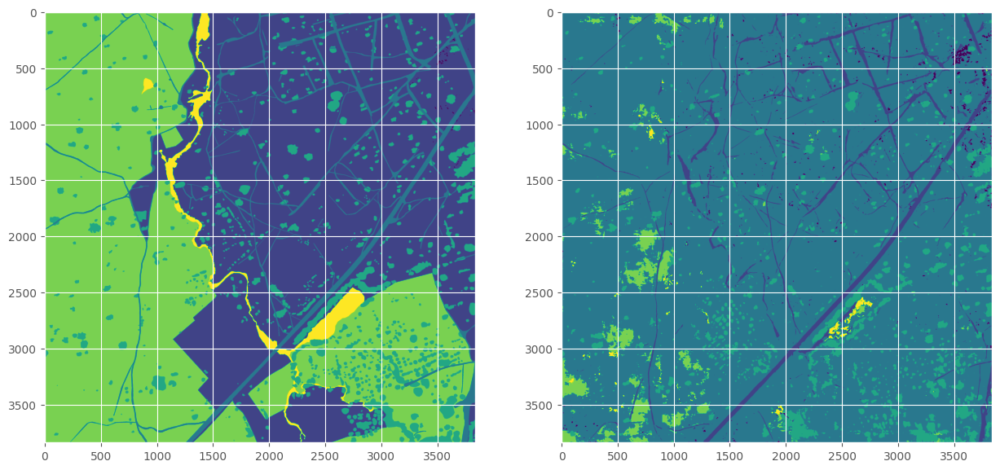

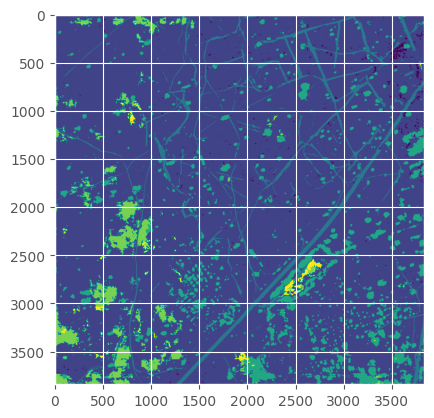

In [122]:
fig=plt.figure(figsize=(15,15)) 
plt.subplot(1,2,1)
plt.imshow(testlabel[0,:,:])
plt.subplot(1,2,2)
plt.imshow(sortpred)
plt.show()
# plt.subplot(1,3,3)
plt.imshow(h_pred_mask)
plt.show()

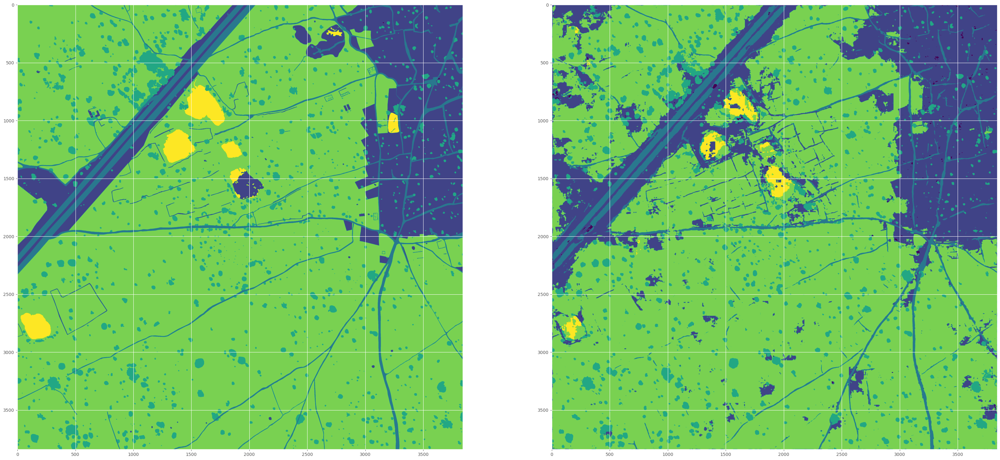

In [48]:
fig=plt.figure(figsize=(40,20)) 
plt.subplot(1,2,1)
plt.imshow(testlabel[1,:,:])
plt.subplot(1,2,2)
plt.imshow(h_pred_mask)
plt.show()